# Human Fall Detection

<a align="left" href="https://ultralytics.com/yolov5" target="_blank">
<img width="1024", src="https://user-images.githubusercontent.com/26833433/125273437-35b3fc00-e30d-11eb-9079-46f313325424.png"></a>

# Setup

Clone repo, install dependencies and check PyTorch and GPU.

In [1]:
!git clone https://github.com/ultralytics/yolov5  # clone
%cd yolov5
%pip install -qr requirements.txt  # install

from yolov5 import utils
display = utils.notebook_init()  # checks

YOLOv5 🚀 v7.0-388-g882c35fc Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)


Setup complete ✅ (2 CPUs, 12.7 GB RAM, 32.7/112.6 GB disk)


# 1. Inference

`detect.py` runs YOLOv5 inference on a variety of sources, downloading models automatically from the [latest YOLOv5 release](https://github.com/ultralytics/yolov5/releases), and saving results to `runs/detect`. Example inference sources are:

```shell
python detect.py --source 0  # webcam
                          img.jpg  # image
                          vid.mp4  # video
                          path/  # directory
                          path/*.jpg  # glob
                          'https://youtu.be/Zgi9g1ksQHc'  # YouTube
                          'rtsp://example.com/media.mp4'  # RTSP, RTMP, HTTP stream
```

In [6]:
!unzip -q ../archive.zip -d../

# 2. Validate
Validate a model's accuracy on Fall Detetction val dataset. Models are downloaded automatically from the [latest YOLOv5 release](https://github.com/ultralytics/yolov5/releases).

# Fall Detection Dataset

Download [Fall Detection](https://www.kaggle.com/uttejkumarkandagatla/fall-detection-dataset) dataset (53MB - 500 images), and test model accuracy.

In [7]:
# Tensorboard  (optional)
%load_ext tensorboard
%tensorboard --logdir runs/train

<IPython.core.display.Javascript object>

# Train YOLOv5s on Custom Dataset for 50 epochs

In [16]:
!python train.py --img 640 --batch 16 --epochs 20 --data custom_data.yaml --weights yolov5s.pt --cache

2024-12-06 07:03:59.429584: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-12-06 07:03:59.450338: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-12-06 07:03:59.456910: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=yolov5s.pt, cfg=, data=custom_data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=20, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, evolve_population=data/hyps, resume_evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False,

# Evaluate Custom YOLOv5 Detector Performance

Training losses and performance metrics are saved to Tensorboard and also to a logfile defined above with the **--name** flag when we train. In our case, we named this `yolov5s_results`. (If given no name, it defaults to `results.txt`.) The results file is plotted as a png after training completes.

Note from Glenn: Partially completed `results.txt` files can be plotted with `from utils.utils import plot_results; plot_results()`.

In [17]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6007 (pid 11046), started 0:19:46 ago. (Use '!kill 11046' to kill it.)

<IPython.core.display.Javascript object>

# Experiment 1

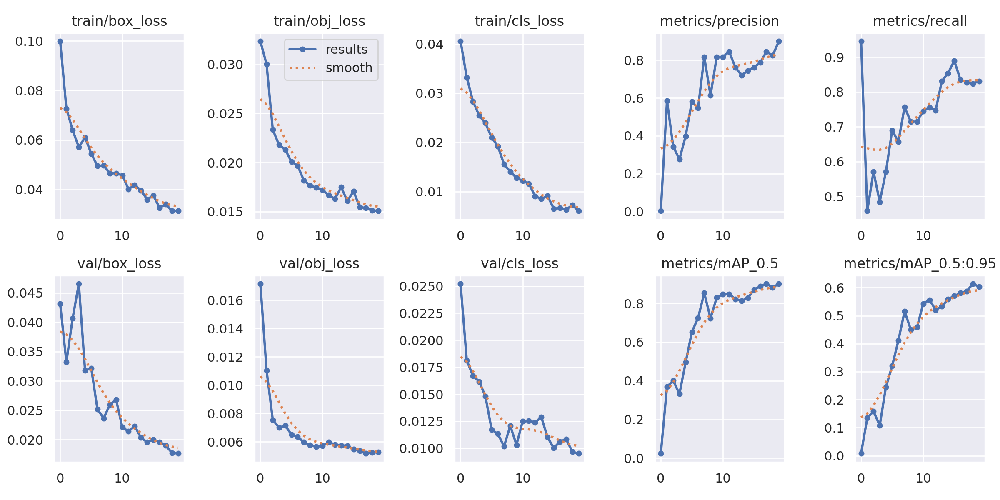

In [18]:
# we can also output some older school graphs if the tensor board isn't working for whatever reason...
from IPython.display import Image
Image(filename='/content/yolov5/runs/train/exp/results.png',width=1000)

### Curious? Visualize Our Training Data with Labels

After training starts, view `train*.jpg` images to see training images, labels and augmentation effects.

Note a mosaic dataloader is used for training (shown below), a new dataloading concept developed by Glenn Jocher and first featured in YOLOv5

# Experiment 2

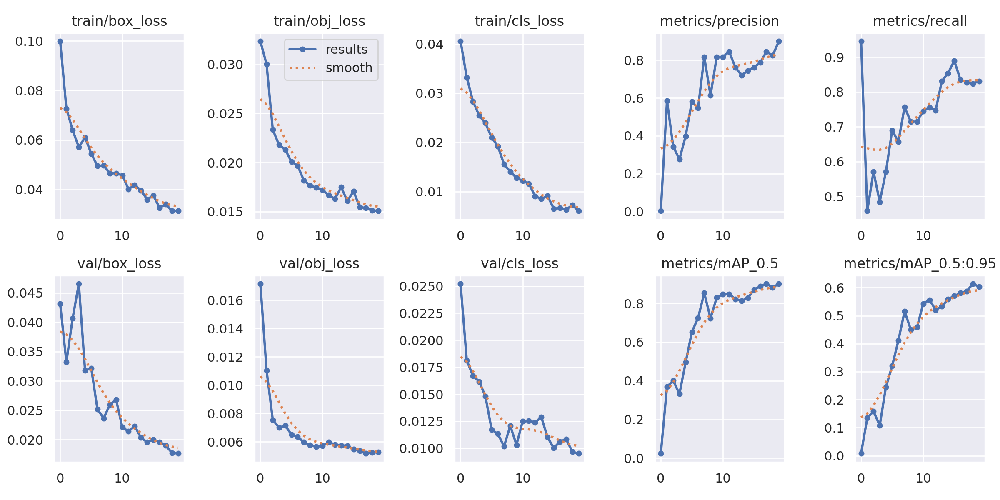

In [19]:
Image(filename='/content/yolov5/runs/train/exp2/results.png',width=1000)

# Training and Testing for 3 Batches

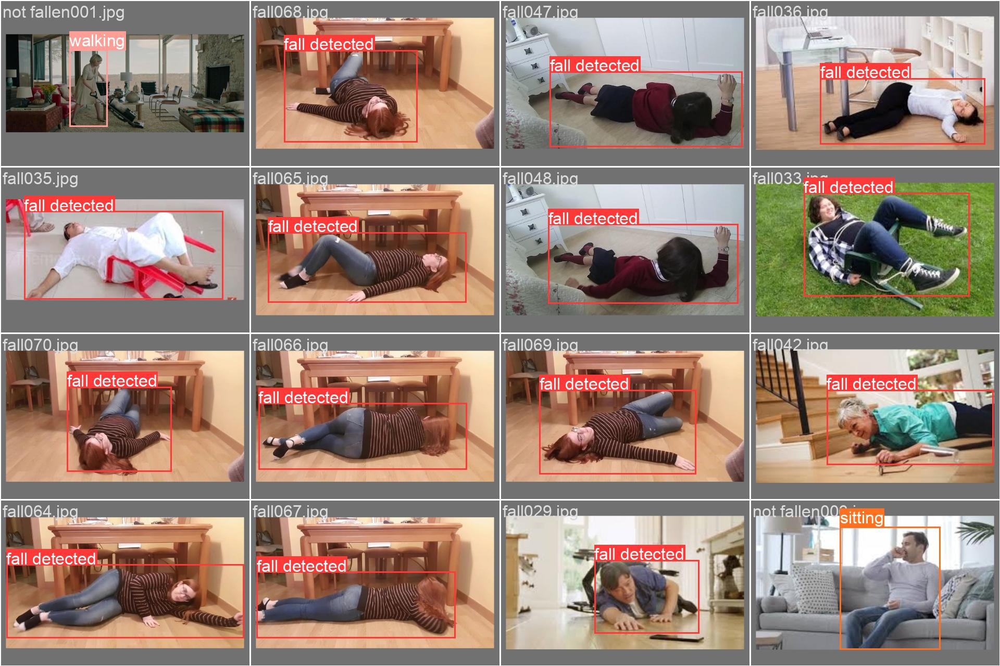

In [20]:
Image(filename='/content/yolov5/runs/train/exp2/val_batch0_labels.jpg',width=1000)

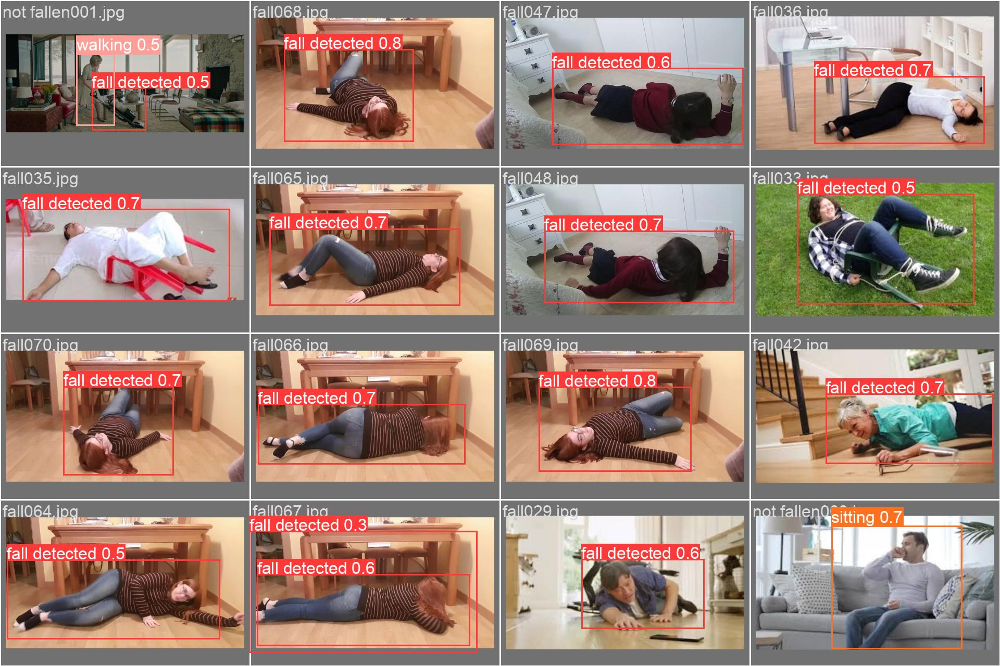

In [21]:
Image(filename='/content/yolov5/runs/train/exp2/val_batch0_pred.jpg',width=1000)

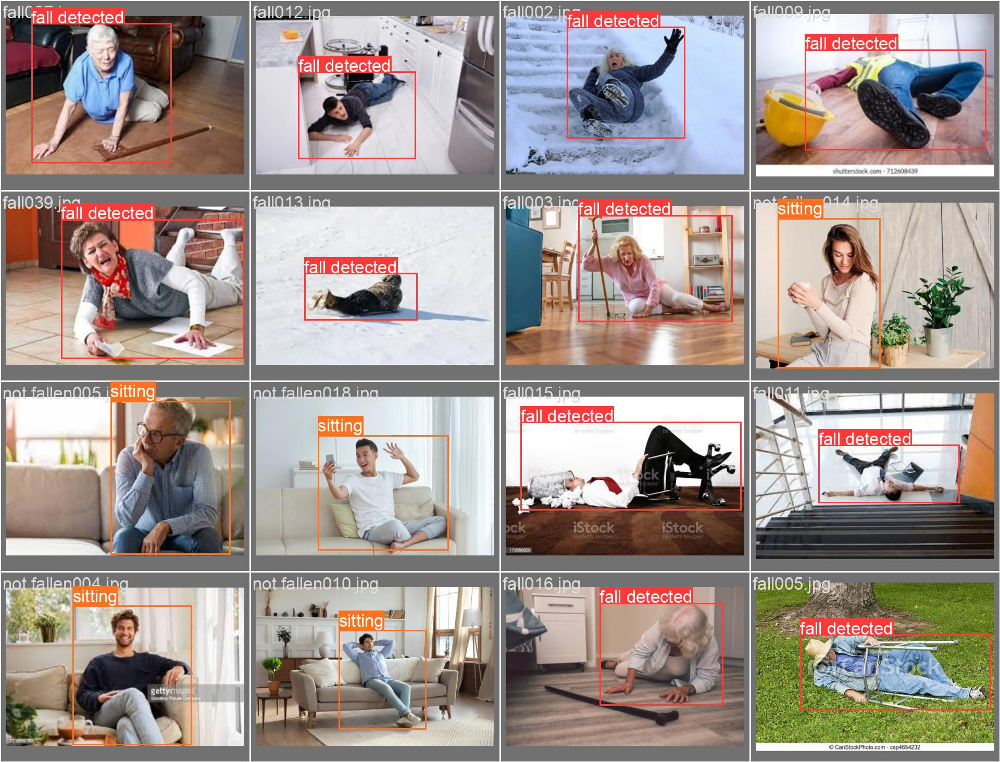

In [22]:
Image(filename='/content/yolov5/runs/train/exp2/val_batch1_labels.jpg',width=1000)

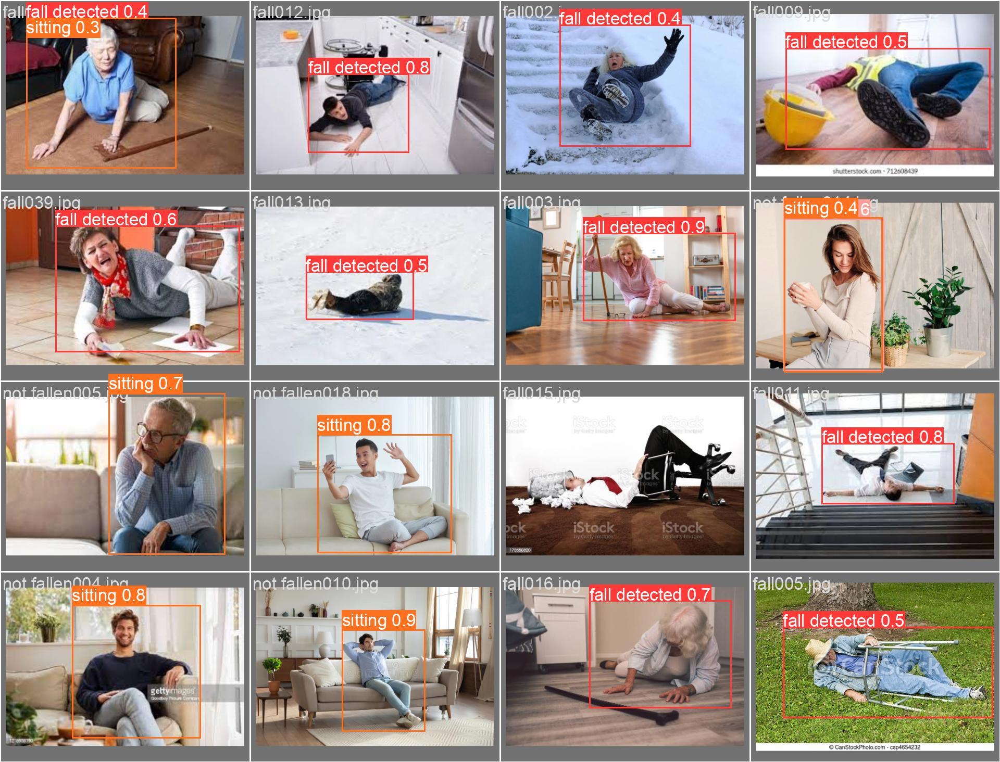

In [23]:
Image(filename='/content/yolov5/runs/train/exp2/val_batch1_pred.jpg',width=1000)

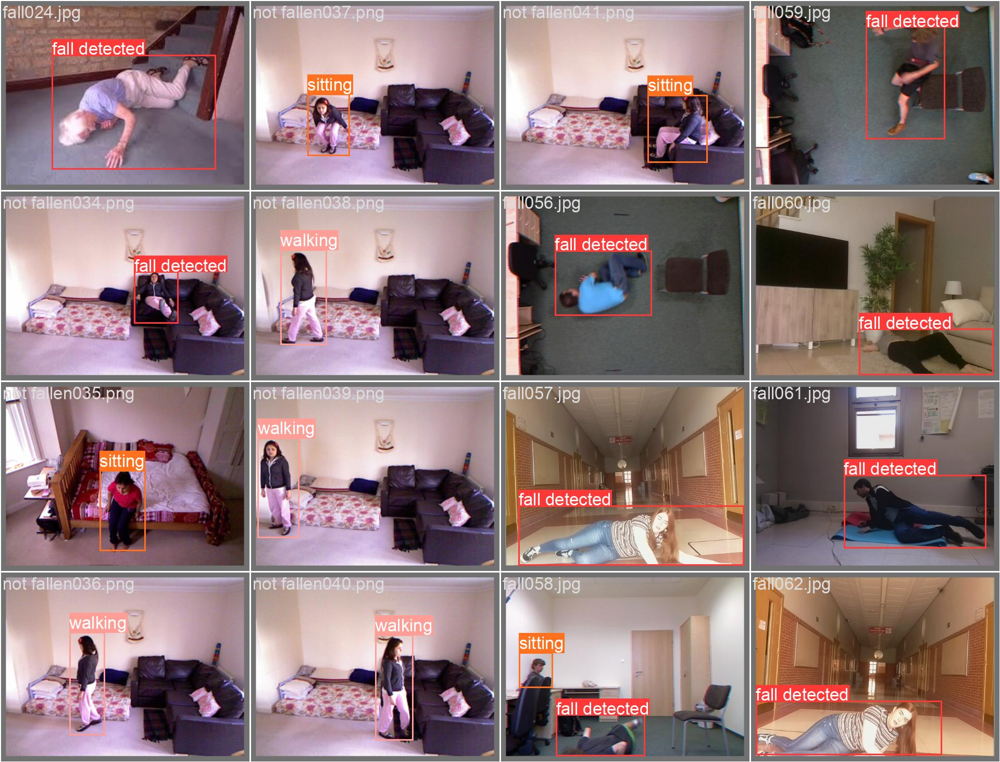

In [24]:
Image(filename='/content/yolov5/runs/train/exp2/val_batch2_labels.jpg',width=1000)

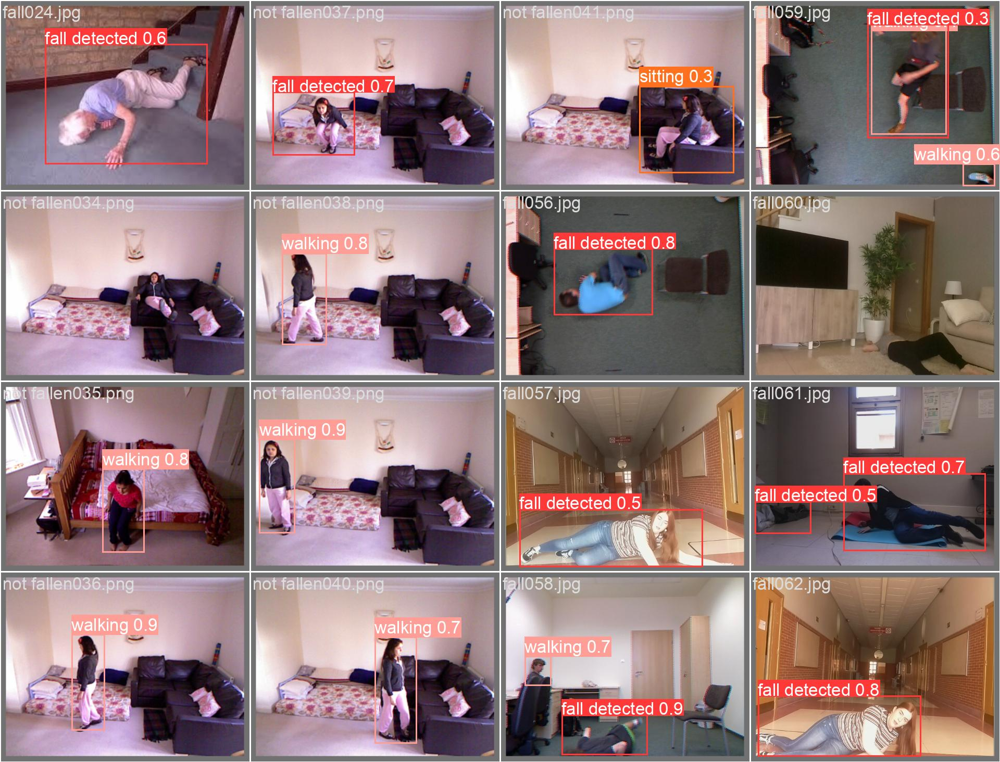

In [25]:
Image(filename='/content/yolov5/runs/train/exp2/val_batch2_pred.jpg',width=1000)

#Run Inference  With Trained Weights
Run inference with a pretrained checkpoint on contents of `test/images` folder.

In [26]:
%ls runs/train/exp2/weights

best.pt  last.pt


In [29]:
!python detect.py --weights runs/train/exp2/weights/best.pt --img 640 --conf 0.25 --source fall_detection_1.mp4

detect: weights=['runs/train/exp2/weights/best.pt'], source=fall_detection_1.mp4, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_format=0, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-388-g882c35fc Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7018216 parameters, 0 gradients, 15.8 GFLOPs
WARNING ⚠️ NMS time limit 0.550s exceeded
video 1/1 (1/180) /content/yolov5/fall_detection_1.mp4: 384x640 1 walking, 42.9ms
video 1/1 (2/180) /content/yolov5/fall_detection_1.mp4: 384x640 1 walking, 7.5ms
video 1/1 (3/180) /content/yolov5/fall_detection_1.mp4: 384x640 1 walking, 7.5ms
video 1/1 (4/180) /content

In [30]:
!python detect.py --weights runs/train/exp2/weights/best.pt --img 640 --conf 0.25 --source fall_detection_2.mp4

detect: weights=['runs/train/exp2/weights/best.pt'], source=fall_detection_2.mp4, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_format=0, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-388-g882c35fc Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7018216 parameters, 0 gradients, 15.8 GFLOPs
video 1/1 (1/600) /content/yolov5/fall_detection_2.mp4: 640x640 (no detections), 11.4ms
video 1/1 (2/600) /content/yolov5/fall_detection_2.mp4: 640x640 (no detections), 11.4ms
video 1/1 (3/600) /content/yolov5/fall_detection_2.mp4: 640x640 (no detections), 11.4ms
video 1/1 (4/600) /content/yolov5/fall_detection

In [31]:
!python detect.py --weights runs/train/exp2/weights/best.pt --img 640 --conf 0.25 --source fall_detection_3.mp4

detect: weights=['runs/train/exp2/weights/best.pt'], source=fall_detection_3.mp4, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_format=0, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-388-g882c35fc Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7018216 parameters, 0 gradients, 15.8 GFLOPs
video 1/1 (1/1563) /content/yolov5/fall_detection_3.mp4: 448x640 (no detections), 27.3ms
video 1/1 (2/1563) /content/yolov5/fall_detection_3.mp4: 448x640 (no detections), 8.9ms
video 1/1 (3/1563) /content/yolov5/fall_detection_3.mp4: 448x640 (no detections), 9.0ms
video 1/1 (4/1563) /content/yolov5/fall_detecti

In [35]:
!python detect.py --weights runs/train/exp2/weights/best.pt --img 640 --conf 0.25 --source fall_detection_4.mp4

detect: weights=['runs/train/exp2/weights/best.pt'], source=fall_detection_4.mp4, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_format=0, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-388-g882c35fc Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 157 layers, 7018216 parameters, 0 gradients, 15.8 GFLOPs
video 1/1 (1/1346) /content/yolov5/fall_detection_4.mp4: 640x640 (no detections), 11.4ms
video 1/1 (2/1346) /content/yolov5/fall_detection_4.mp4: 640x640 (no detections), 11.4ms
video 1/1 (3/1346) /content/yolov5/fall_detection_4.mp4: 640x640 (no detections), 11.4ms
video 1/1 (4/1346) /content/yolov5/fall_detec

# Export Trained Weights for Future Inference

Now that you have trained your custom detector, you can export the trained weights you have made here for inference on your device elsewhere

In [33]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [36]:
%cp /yolov5/runs/detect/exp2/fall_detection_1.mp4 /content/gdrive/My\ Drive

cp: cannot stat '/yolov5/runs/detect/exp2/fall_detection_1.mp4': No such file or directory


In [ ]:
%cp /content/yolov5/runs/detect/exp3/fall_detection_2.mp4 /content/gdrive/My\ Drive

In [ ]:
%cp /content/yolov5/runs/detect/exp4/fall_detection_3.mp4 /content/gdrive/My\ Drive

In [ ]:
%cp /content/yolov5/runs/detect/exp5/fall_detection_4.mp4 /content/gdrive/My\ Drive

In [ ]:
%cp /content/yolov5/runs/train/exp2/weights/best.pt /content/gdrive/My\ Drive